# 2D Transition path theory tutorial

In [1]:
using Random, Distributions, StatsBase
using LinearAlgebra, ApproxFun
using Zygote, DifferentialEquations
using Plots, StatsPlots, LaTeXStrings

The Mueller potential is defined as

$$
V(x,y) = \sum_{i=1}^4 A_i\exp\left( a_i(x-\xi_i)^2 + b_i(x-\xi_i)(y-\eta_i) + c_i(y-\eta_i)^2 \right)
$$

In [2]:
v(x,y,θ) = sum(θ.A.*exp.(θ.a.*(x.-θ.ξ).^2 + θ.b.*(x.-θ.ξ).*(y.-θ.η) + θ.c.*(y.-θ.η).^2))

v (generic function with 1 method)

In [3]:
A = [-200,-100,-170,15]
a = [-1,-1,-6.5,0.7]
b = [0,0,11,0.6]
c = [-10,-10,-6.5,0.7]
ξ = [1,0,-0.5,-1]
η = [0,0.5,1.5,1]
Σ = 10.0*I(2)    # ASSUME diagonal noise!
D = Σ*Σ'/2
θ = (A=A,a=a,b=b,c=c,ξ=ξ,η=η,Σ=Σ)

(A = [-200, -100, -170, 15], a = [-1.0, -1.0, -6.5, 0.7], b = [0.0, 0.0, 11.0, 0.6], c = [-10.0, -10.0, -6.5, 0.7], ξ = [1.0, 0.0, -0.5, -1.0], η = [0.0, 0.5, 1.5, 1.0], Σ = [10.0 0.0; 0.0 10.0])

In [4]:
xmin,xmax = -1.5,1.2
ymin,ymax = -0.2,2

(-0.2, 2)

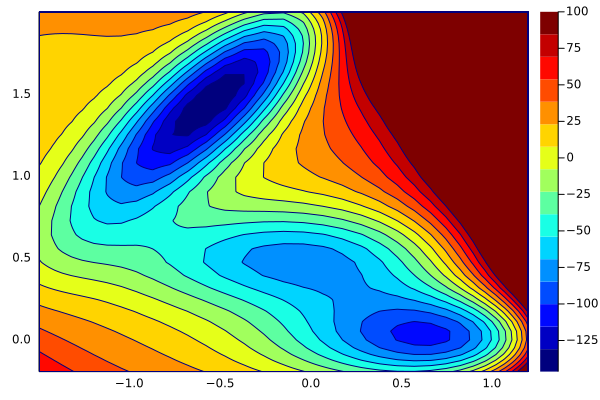

In [6]:
X = Chebyshev(xmin..xmax)
Y = Chebyshev(ymin..ymax)
Ω = X*Y
V = Fun((x,y)->v(x,y,θ),Ω)
contour(V,color=:jet,clims=(-Inf,100),fill=true)

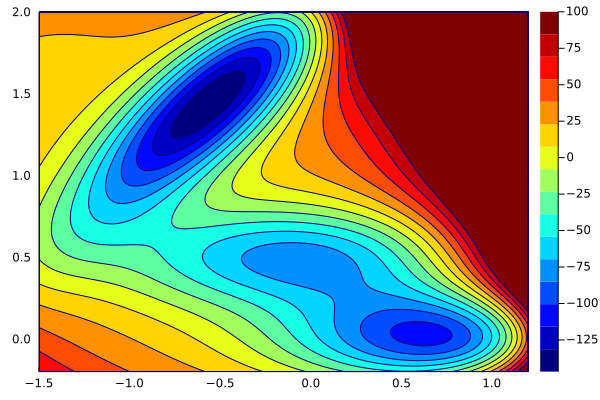

In [7]:
Nx,Ny = 200,200
x = range(xmin,xmax,Nx)
y = range(ymin,ymax,Ny)
Δx = (xmax-xmin)/(Nx-1)
Δy = (ymax-ymin)/(Ny-1)
V = reshape([v(ξ,η,θ) for η ∈ y for ξ ∈ x],length(x),length(y))
fig = contour(x,y,V',color=:jet,clims=(-Inf,100),fill=true)

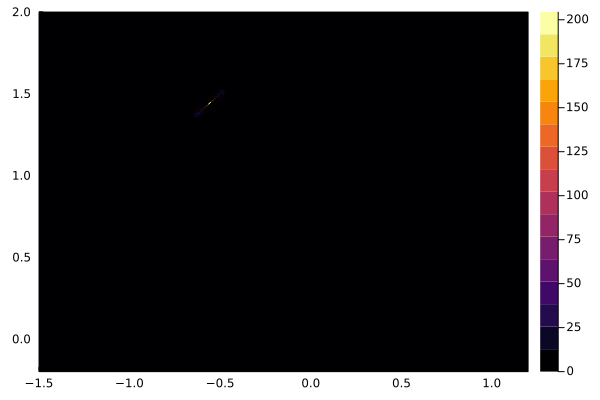

In [8]:
πxy = exp.(-Vxy)/D
Z = sum(πxy)*Δx*Δy
πxy = πxy/Z
contour(x,y,πxy',fill=true)

In [12]:
μ(u,θ,t) = -collect(gradient((x,y)->v(x,y,θ),u...))   # -∇V(x,y)
σ(u,θ,t) = diag(θ.Σ)    # diag(Σ)

σ (generic function with 1 method)

In [16]:
tspan = (0.0,10.0)
u0 = [x[argmin(V)[1]],y[argmin(V)[2]]]

Random.seed!(0)
sde = SDEProblem(μ,σ,u0,tspan,θ)
u = solve(sde)
#U = [solve(sde) for i ∈ 1:10];

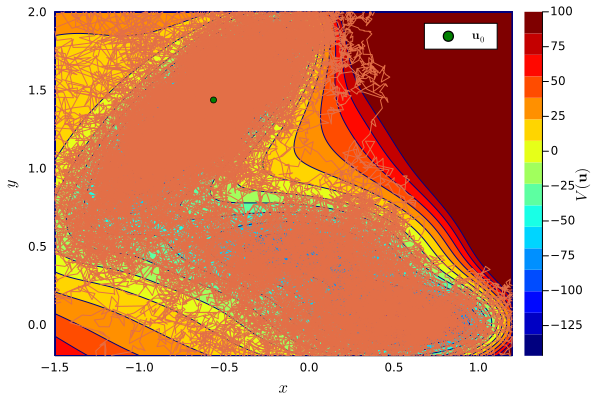

In [14]:
xlims,ylims = (xmin,xmax),(ymin,ymax)
fig = plot(xlabel=L"x",ylabel=L"y",cbartitle=L"V(\mathbf{u})")
fig = contour!(x,y,V',color=:jet,clims=(-Inf,100),fill=true)
fig = plot!(u,vars=(1,2),width=0.1,xlims=xlims,ylims=ylims,label=false)
#for u ∈ U fig = plot!(u,vars=(1,2),xlims=xlims,ylims=ylims,label=false) end
fig = scatter!([u0[1]],[u0[2]],color=:green,label=L"\mathbf{u}_0",fmt=:png)

In [17]:
plot(u)

In [108]:
f(u,θ,t) = -collect(gradient((x,y)->v(x,y,θ),u[1],u[2]))
g(u,θ,t) = [θ.Σ[1,1],θ.Σ[2,2]]

Random.seed!(0)
u1 = solve(SDEProblem(f,g,u0,(0.0,10.0),θ))
plot(u1)